<a href="https://colab.research.google.com/github/Chiaradisanto/Segmentation/blob/main/SalvataggioDICOMfinale.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/gdrive')

Mounted at /gdrive


In [ ]:
%matplotlib inline

import numpy as np # linear algebra
import pandas as pd # 

import os
import scipy.ndimage
import matplotlib.pyplot as plt

from skimage import measure, morphology
from mpl_toolkits.mplot3d.art3d import Poly3DCollection

In [ ]:
!pip install pynrrd


In [ ]:
!pip install pydicom


     |████████████████████████████████| 2.0 MB 5.3 MB/s 


In [ ]:
import pydicom

In [ ]:
from pydicom import dcmread

In [ ]:
def get_names(path):
    names = []
    for root, dirnames, filenames in os.walk(path):
        for filename in filenames:
            _, ext = os.path.splitext(filename)
            if ext in ['.dcm']:
                names.append(filename)
    return names

In [ ]:
path='/gdrive/MyDrive/TESI/AMPATIENTS/AM-037/20150923-CT Thorax and abdomen with contrast/6-HALF 75_ 0.78s Cardiac 0.5 CE Heart 30s'

In [ ]:
names = sorted(get_names(path))

In [ ]:
files = []
for x in names:
   
        files.append(pydicom.dcmread(path+'/'+x))

In [ ]:
len(files)

160

In [ ]:

slices = []
skipcount = 0
for f in files:
    if hasattr(f, 'SliceLocation'):
        slices.append(f)
    else:
        skipcount = skipcount + 1

print("skipped, no SliceLocation: {}".format(skipcount))

skipped, no SliceLocation: 0


In [ ]:
# ensure they are in the correct order
slices = sorted(slices, key=lambda s: s.SliceLocation, reverse=True)

In [ ]:
from matplotlib import pyplot as plt

In [ ]:
from  scipy import ndimage


In [ ]:
def dicom_HU(scan):
  

    image = np.stack([s.pixel_array*s.RescaleSlope+s.RescaleIntercept for s in scan],axis=2).astype(np.int16)
    image[image < -1900] = -1000
    

    img_min = 120 - 120 // 2
    img_max = 120 + 120 // 2
    window_image = image.copy()
    window_image[window_image < img_min] = img_min
    window_image[window_image > img_max] = img_max





    plt.figure(figsize=(20, 10))
    plt.style.use('grayscale')

    plt.subplot(151)
    plt.imshow(image[:,:,0], cmap='gray')
    plt.title('Original')
    plt.axis('off')

    plt.subplot(152)
    plt.imshow(window_image[:,:,0], cmap='gray')
    plt.title('Hu image')
    plt.axis('off')
    return  np.array(window_image)
   

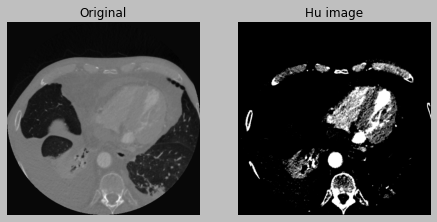

In [ ]:
scan1=dicom_HU(slices[60:61])


In [ ]:

def dicom_HU(scan):
    image = np.stack([s.pixel_array*s.RescaleSlope+s.RescaleIntercept for s in scan],axis=2).astype(np.int16)
    image[image < -1990] = -1000

    img_min = 120 - 120 // 2
    img_max = 120 + 120 // 2
    window_image = image.copy()
    window_image[window_image < img_min] = img_min
    window_image[window_image > img_max] = img_max
    plt.figure(figsize=(20, 10))
    plt.style.use('grayscale')


    plt.imshow(window_image[:,:,0], cmap='gray')
 
    plt.axis('off')
    return  np.array(window_image)
   

In [ ]:
images_path='/gdrive/MyDrive/TESI/VALIDATION/AM-037/images/000'

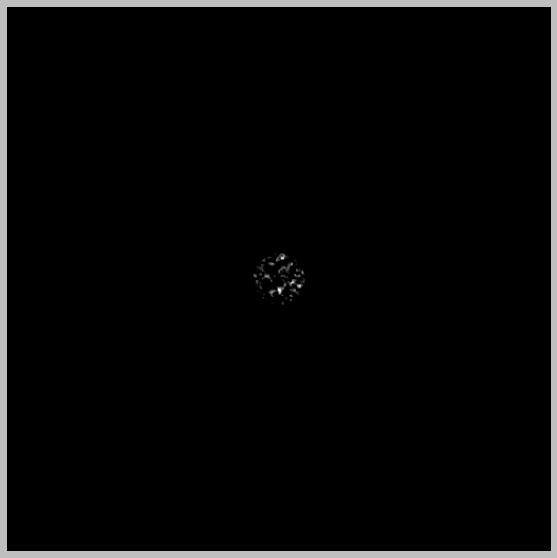

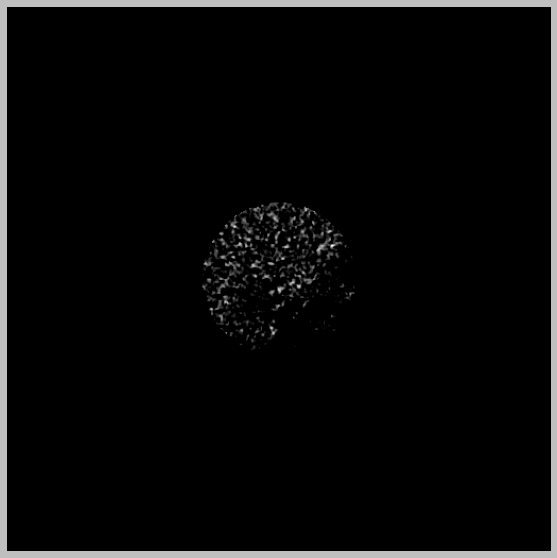

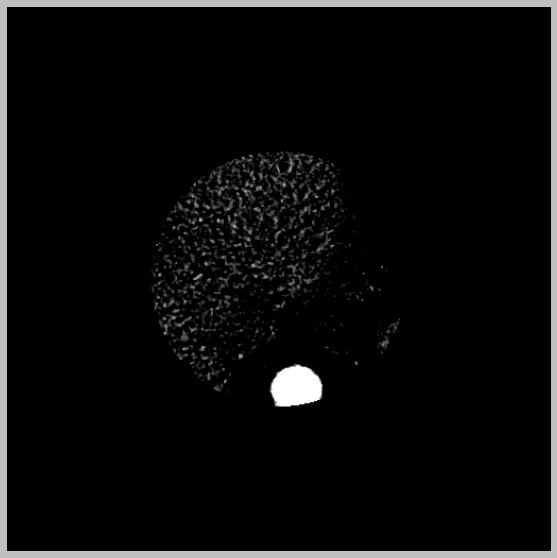

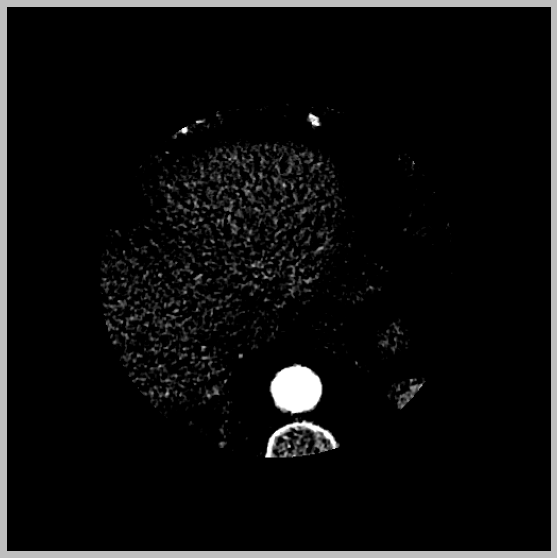

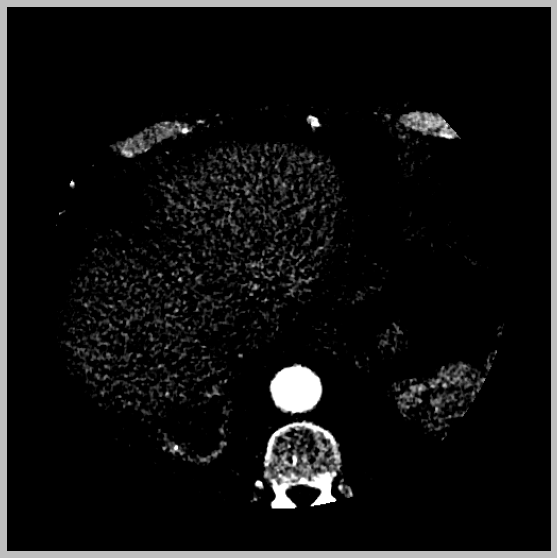

...

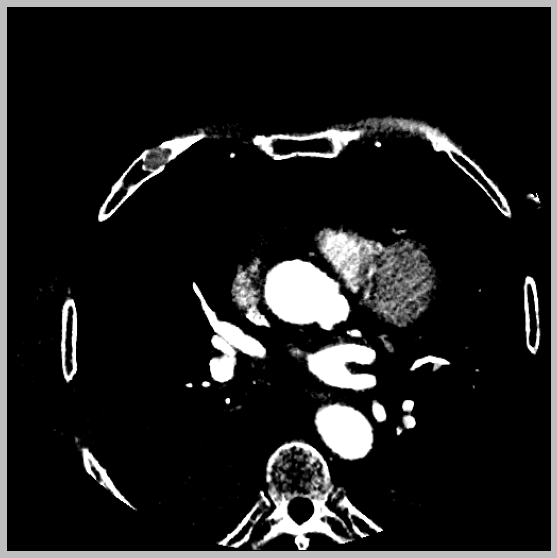

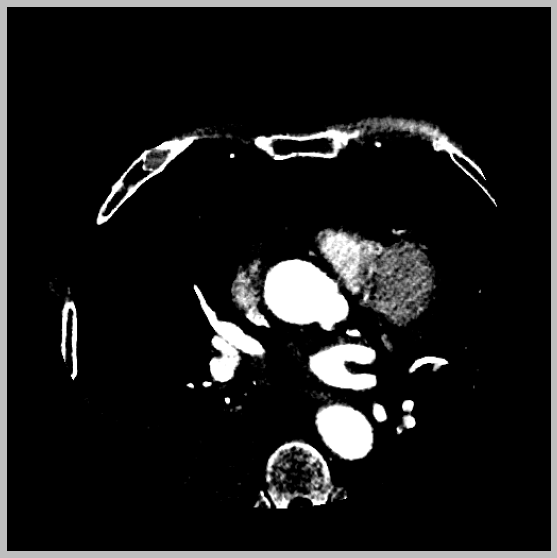

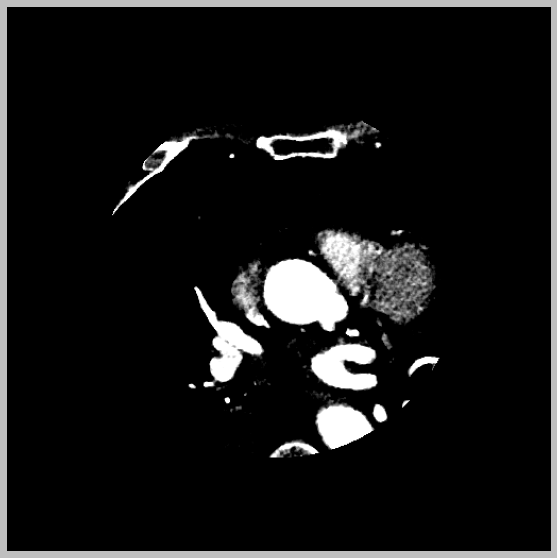

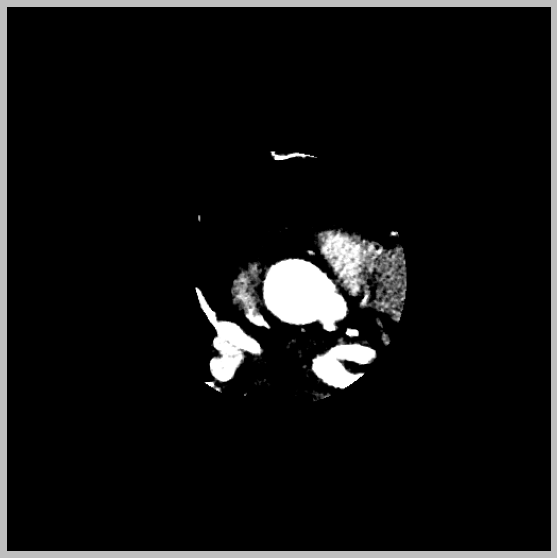

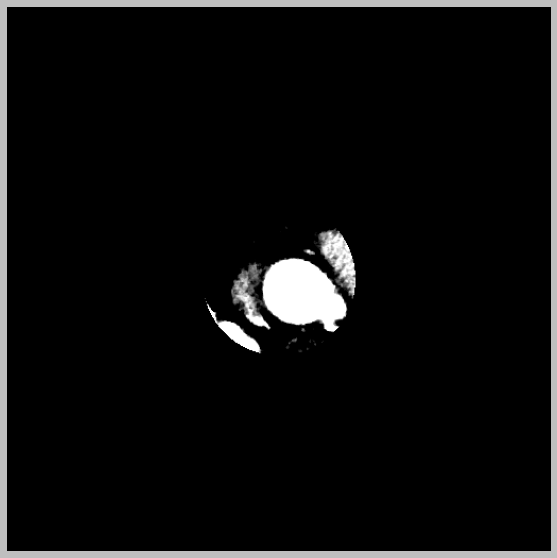

In [ ]:
num_slices=160
for i in range(1,num_slices):
    scan=dicom_HU(slices[i-1:i])
    plt.axis('off')
    plt.savefig(f"{images_path}"+str(i)+".png", bbox_inches='tight',pad_inches = 0,dpi=300, quality=95)
    plt.show()
